<a href="https://colab.research.google.com/github/berthine/Research_Project_T-bingen_Cg/blob/main/BioviL0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install clip


  Preparing metadata (setup.py) ... done
  Created wheel for clip: filename=clip-0.2.0-py3-none-any.whl size=6989 sha256=63ca92013f1fa0784c6236c1ea8dbd878c64a909315cbc9a97d50959a1a4fa53
  Stored in directory: /root/.cache/pip/wheels/7f/5c/e6/2c0fdb453a3569188864b17e9676bea8b3b7e160c037117869
Successfully built clip


In [78]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import roc_auc_score
from PIL import Image
from tqdm.auto import tqdm
from typing import Dict
from pathlib import Path
import logging
import time
import os
import math
from prettytable import PrettyTable
from copy import deepcopy
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader, random_split
from torchvision.models import densenet121
from torch.optim import Adam, lr_scheduler
from torchvision import datasets, transforms, models
import albumentations as A
from albumentations.pytorch import ToTensorV2
import clip
import torchvision.transforms as transforms
from transformers import CLIPProcessor, CLIPModel, CLIPTokenizer
device = "cuda" if torch.cuda.is_available() else "cpu"

The BioViL-T image and text models in a multimodal phrase grounding setting. Given a chest X-ray and a radiology text phrase, the joint model grounds the phrase in the image, i.e., highlights the regions of the image that share features similar to the phrase.

In [ ]:
pip_source = "hi-ml-multimodal"

In [ ]:
pip install {pip_source}

In [79]:
from typing import List
from typing import Tuple

import tempfile
from pathlib import Path
import matplotlib.pyplot as plt
from skimage import io
import torch
from IPython.display import display
from IPython.display import Markdown
import numpy as np

from health_multimodal.common.visualization import plot_phrase_grounding_similarity_map
from health_multimodal.common.visualization import _plot_heatmap, _plot_image
from health_multimodal.text import get_bert_inference
from health_multimodal.text.utils import BertEncoderType
from health_multimodal.image import get_image_inference
from health_multimodal.image.utils import ImageModelType
from health_multimodal.image import ImageInferenceEngine
from health_multimodal.text import TextInferenceEngine
from health_multimodal.vlp.inference_engine import ImageTextInferenceEngine

In [80]:
from health_multimodal.image.model.pretrained import get_biovil_image_encoder
from health_multimodal.image.model.pretrained import get_biovil_t_image_encoder
from health_multimodal.vlp import inference_engine
from health_multimodal.text.model.configuration_cxrbert import CXRBertTokenizer
from health_multimodal.text.model import  CXRBertModel
from health_multimodal.text.inference_engine import TextInferenceEngine


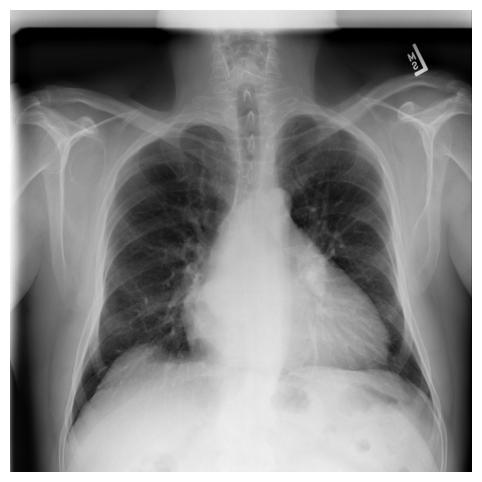

In [81]:
# text_emb = get_embeddings_from_prompt(TextInferenceEngine
xray = Image.open("/content/drive/MyDrive/Tubingen_Research/images_samples/00000001_001.png").convert('RGB')
fig, ax = plt.subplots(figsize=(8, 6))
_plot_image(xray, ax )

In [ ]:
"Image size"
xray.size

(1024, 1024)

In [ ]:
# Load the text and image models
text_inference = get_bert_inference(BertEncoderType.BIOVIL_T_BERT)
image_inference = get_image_inference(ImageModelType.BIOVIL_T)

# Instantiate the joint inference engine

image_text_inference = ImageTextInferenceEngine(
    image_inference_engine=image_inference,
    text_inference_engine=text_inference,
)
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
image_text_inference.to(device)

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


tokenizer_config.json:   0%|          | 0.00/741 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/235k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

The tokenizer class you load from this checkpoint is not the same type as the class this function is called from. It may result in unexpected tokenization. 
The tokenizer class you load from this checkpoint is 'BertTokenizer'. 
The class this function is called from is 'CXRBertTokenizer'.
/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


config.json:   0%|          | 0.00/770 [00:00<?, ?B/s]

You are using a model of type bert to instantiate a model of type cxr-bert. This is not supported for all configurations of models and can yield errors.


pytorch_model.bin:   0%|          | 0.00/441M [00:00<?, ?B/s]

Some weights of the model checkpoint at microsoft/BiomedVLP-BioViL-T were not used when initializing CXRBertModel: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight']
- This IS expected if you are initializing CXRBertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing CXRBertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


100%|██████████| 109745561/109745561 [00:01<00:00, 83083495.79it/s]
/usr/local/lib/python3.10/dist-packages/health_multimodal/image/model/model.py:66: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this 

In [ ]:
text_prompt = ["Lung volume loss",
"Tracheal deviation",
"Mediastinal shift",
"Enlarged cardiac silhouette",
"Displacement of interlobar fissures",
"Mediastinal shift towards the affected area",
"Elevation of the hemidiaphragm",
"Elevated diaphragm",
"Displaced fissures",
"Crowded bronchovascular markings",
"Silhouette sign"]
# text_E = get_emeddings_from_prompt()
# text_ebdg = TextInferenceEngine(tokenizer= text_E)
text_embeddings = text_inference.get_embeddings_from_prompt(text_prompt)
print(text_embeddings.shape)

torch.Size([11, 128])


In [ ]:
text_embeddings[0]

tensor([-0.0536,  0.0770,  0.0627,  0.0392, -0.1106,  0.1302, -0.1624, -0.3219,
        -0.1038, -0.0251,  0.1208, -0.0703, -0.0518, -0.0404, -0.0997, -0.0311,
         0.0237,  0.1381,  0.0455,  0.0433,  0.0981,  0.0799, -0.0990, -0.1396,
        -0.1298, -0.0711, -0.1090, -0.1108, -0.1073, -0.0050, -0.0674,  0.0077,
         0.1198,  0.0822,  0.0695,  0.0459, -0.0223,  0.1327, -0.0841, -0.2313,
         0.0675, -0.0443,  0.1029, -0.0577,  0.0543, -0.0247, -0.0015, -0.0063,
         0.0581, -0.1406, -0.1251,  0.1486, -0.0828,  0.0529,  0.1520,  0.0999,
         0.1148, -0.0006,  0.0461,  0.1172, -0.0304, -0.0145, -0.0979,  0.0059,
        -0.0594,  0.0099, -0.0302, -0.0633, -0.0086, -0.0259, -0.0190,  0.1071,
        -0.0502,  0.0567, -0.1543, -0.0089, -0.1551,  0.1292, -0.1009,  0.0205,
         0.0408,  0.1077, -0.0287,  0.0328, -0.1276,  0.0275,  0.0660, -0.0179,
         0.0188,  0.0341, -0.0920, -0.1024,  0.0193,  0.0617, -0.0681,  0.0919,
         0.0696,  0.0178,  0.0263, -0.02

In [84]:
image_path = Path("/content/drive/MyDrive/Tubingen_Research/images_samples/00000001_001.png")

similarity_map = image_text_inference.get_similarity_map_from_raw_data(
        image_path=image_path
        ,
        query_text="volum loss",
        # interpolation="bilinear",
    )
print(similarity_map)

[[nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 ...
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]
 [nan nan nan ... nan nan nan]]


nan


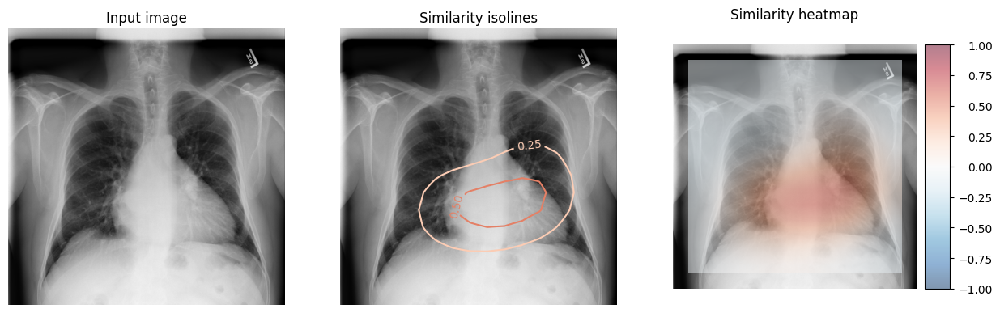

In [ ]:
image_path = Path("/content/drive/MyDrive/Tubingen_Research/images_samples/00000001_001.png")
TypeBox = Tuple[float, float, float, float]
text_prompt ="Enlarged cardiac silhouette"

def plot_phrase_grounding(image_path: Path, text_prompt: str) -> None:
    similarity_map = image_text_inference.get_similarity_map_from_raw_data(
        image_path=image_path,
        query_text=text_prompt,
        interpolation="bilinear",
    )

    plot_phrase_grounding_similarity_map(
        image_path=image_path,
        similarity_map=similarity_map,

    )
    # print(np.isnan(similarity_map).all())
    # print(np.min(similarity_map))


def plot_phrase_grounding_from_url(image_path, text_prompt: str) -> None:
    # image_path = Path(tempfile.tempdir, "downloaded_chest_xray.jpg")
    # !curl -s -L -o {image_path} {image_url}
    plot_phrase_grounding(image_path, text_prompt)
plot_phrase_grounding_from_url(image_path, text_prompt)

In [ ]:
image_path = Path("/content/drive/MyDrive/Tubingen_Research/images_samples/00000001_001.png")
similarity_score = []
for i in text_prompt:
  sim = image_text_inference.get_similarity_score_from_raw_data(image_path=image_path,query_text=i)

    # sim =image_text_inference.get_similarity_score_from_raw_data(image_path=image_path,query_text=i)
  similarity_score.append(sim)
print(similarity_score)

[-0.5238397121429443, -0.5564651489257812, -0.383257657289505, -0.5195768475532532, -0.565580427646637, -0.5106452107429504, -0.5238397121429443, -0.5964208245277405, -0.20004594326019287, -0.6209186911582947, -0.5195768475532532, -0.565580427646637, -0.5964208245277405, -0.4373890161514282, -0.5195768475532532, -0.6209186911582947, -0.20004594326019287, -0.5457636713981628, -0.4373890161514282, -0.383257657289505, -0.7010924220085144, -0.5108975172042847, -0.5909149646759033, -0.5238397121429443, -0.5854980945587158, -0.5854980945587158, -0.5238397121429443]


In [ ]:
from transformers import BertForMaskedLM, BertTokenizer
from health_multimodal.text.data.io import TextInput
from typing import Any, List, Union
from health_multimodal.text.model.modelling_cxrbert import CXRBertModel
from health_multimodal.text.model.configuration_cxrbert import CXRBertConfig

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
config = CXRBertConfig()
text_model = CXRBertModel(config)

text_inference_engine = TextInferenceEngine(tokenizer= tokenizer, text_model=text_model)

tokenizer_config.json:   0%|          | 0.00/48.0 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

config.json:   0%|          | 0.00/570 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [ ]:
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
config = CXRBertConfig()  # This config needs to be initialized properly based on your use case
text_model = CXRBertModel(config)

# Define the TextInferenceEngine class
class TextInferenceEngine_l:
    """
    Text inference class that implements functionalities required to extract
    sentence embedding, similarity and MLM prediction tasks.
    """

    def __init__(self, tokenizer: BertTokenizer, text_model: CXRBertModel) -> None:
        self.tokenizer = tokenizer
        self.model = text_model
        self.max_allowed_input_length = self.model.config.max_position_embeddings
        self.model.eval()  # Ensure the model is in evaluation mode

    def is_in_eval(self) -> bool:
        """Returns True if the model is in eval mode."""
        return not self.model.training

    def tokenize_input_prompts(self, prompts: Union[str, List[str]], verbose: bool = True) -> Any:
        tokenizer_output = self.tokenizer(prompts, return_tensors='pt', padding=True, truncation=True)
        device = next(self.model.parameters()).device
        tokenizer_output['input_ids'] = tokenizer_output['input_ids'].to(device)
        tokenizer_output['attention_mask'] = tokenizer_output['attention_mask'].to(device)

        max_length = tokenizer_output['input_ids'].shape[1]
        if max_length > self.max_allowed_input_length:
            raise ValueError(
                f"The sequence length of the input ({max_length}) is "
                f"longer than the maximum allowed sequence length ({self.max_allowed_input_length})."
            )

        if verbose:
            print("Tokenized words:", self.tokenizer.convert_ids_to_tokens(tokenizer_output['input_ids'][0]))

        return tokenizer_output

    @torch.no_grad()
    def get_embeddings_from_prompt(
        self, prompts: Union[str, List[str]], normalize: bool = True, verbose: bool = True
    ) -> torch.Tensor:
        """Generate L2-normalised embeddings for a list of input text prompts."""

        assert self.is_in_eval()
        tokenizer_output = self.tokenize_input_prompts(prompts=prompts, verbose=verbose)
        txt_emb = self.model.get_projected_text_embeddings(  # This method is in CXRBertModel
            input_ids=tokenizer_output['input_ids'],
            attention_mask=tokenizer_output['attention_mask'],
            normalize_embeddings=normalize,
        )

        return txt_emb

    @torch.no_grad()
    def get_pairwise_similarities(
        self, prompt_set_1: Union[str, List[str]], prompt_set_2: Union[str, List[str]]
    ) -> torch.Tensor:
        """Compute pairwise cosine similarities between the embeddings of the given prompts."""

        emb_1 = self.get_embeddings_from_prompt(prompts=prompt_set_1, verbose=False)
        emb_2 = self.get_embeddings_from_prompt(prompts=prompt_set_2, verbose=False)
        sim = torch.mm(emb_1, emb_2.t())
        return sim

# Create an instance of TextInferenceEngine
Text_inference_engine = TextInferenceEngine_l(tokenizer=tokenizer, text_model=text_model)

# Example usage
prompts = ["Enlarged cardiac silhouette.", "Silhouette sign"]
embeddings = Text_inference_engine.get_embeddings_from_prompt(prompts)
print("Embeddings:", embeddings.shape)

Tokenized words: ['[CLS]', 'enlarged', 'cardiac', 'silhouette', '.', '[SEP]']
Embeddings: torch.Size([2, 128])


In [ ]:
Text_inference_engine.get_pairwise_similarities(prompts, prompts)

tensor([[1.0000, 0.9101],
        [0.9101, 1.0000]])

In [ ]:
Text_inference_engine.get_embeddings_from_prompt(prompts)

Tokenized words: ['[CLS]', 'enlarged', 'cardiac', 'silhouette', '.', '[SEP]']


tensor([[ 0.0753,  0.0427, -0.0778,  0.0280,  0.0212, -0.0661,  0.0550,  0.0325,
         -0.0292, -0.0374, -0.1845, -0.0396, -0.0477, -0.0225,  0.1316,  0.0815,
         -0.0340,  0.0677,  0.0467,  0.0460, -0.0292,  0.0994, -0.0309,  0.1206,
         -0.0331,  0.1503, -0.0116,  0.0429, -0.0989,  0.1670,  0.0554, -0.1072,
          0.0611,  0.0561, -0.2116,  0.0491, -0.0798, -0.1761,  0.0571,  0.0458,
          0.1193, -0.0074, -0.0853,  0.0008,  0.0238, -0.1155, -0.0436, -0.0711,
          0.0378, -0.0798,  0.2218, -0.0672,  0.0565,  0.0253, -0.1232, -0.0471,
          0.0013, -0.0720,  0.0260, -0.0448, -0.0661,  0.0468,  0.0911, -0.0611,
         -0.1534,  0.0181,  0.0656, -0.0429,  0.1182, -0.0232, -0.1612,  0.0565,
          0.0498, -0.0295,  0.1467,  0.0597, -0.0604,  0.0127, -0.0412, -0.1281,
          0.0620,  0.0610, -0.0719, -0.0221,  0.0018,  0.0905,  0.0076, -0.0015,
          0.0736, -0.0223,  0.0134,  0.0354,  0.1141, -0.0860,  0.0308,  0.0483,
         -0.0362, -0.0086, -

In [ ]:

Text_inference_engine.get_embeddings_from_prompt('Volume loss')

Tokenized words: ['[CLS]', 'volume', 'loss', '[SEP]']


tensor([[ 5.2521e-02,  1.6231e-02, -5.2775e-03,  3.0130e-02,  6.5592e-02,
         -1.1019e-01,  1.3200e-01,  7.3355e-02, -1.6810e-02, -5.3435e-02,
         -1.6289e-01, -1.4330e-02, -4.3261e-03,  2.9639e-02,  7.9370e-02,
          8.5347e-02, -9.2108e-02,  9.2096e-02, -4.4184e-02,  2.2033e-02,
          8.1762e-02,  9.1496e-02, -7.7584e-02,  7.9510e-02, -8.4180e-02,
          1.4233e-01, -4.0059e-02,  3.5166e-02, -1.1740e-01,  1.0501e-01,
          8.0146e-02, -9.9313e-02,  5.5108e-03,  2.8767e-02, -2.0018e-01,
          4.5972e-02, -9.4062e-02, -1.1279e-01,  3.6332e-02,  2.5135e-02,
          1.3801e-01,  3.7670e-02, -1.1635e-01, -9.3535e-03,  6.1466e-02,
         -9.7099e-03, -2.6115e-02, -1.2335e-01, -7.2777e-03, -7.9587e-02,
          2.1326e-01,  2.1311e-02,  9.0727e-02, -2.5032e-02, -3.7171e-02,
          2.0900e-02, -2.3496e-02, -6.2470e-02, -5.1499e-02, -9.1655e-02,
         -8.3939e-02, -5.7067e-02,  8.6321e-02, -9.4812e-02, -1.8558e-01,
          9.3182e-02,  1.2466e-01, -2.

In [ ]:
import torch.nn.functional as F
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize

from health_multimodal.image.data.io import load_image
from health_multimodal.image.data.transforms import infer_resize_params
from health_multimodal.image.model.model import BaseImageModel
from health_multimodal.image.model.model  import ImageModel, MultiImageModel
from health_multimodal.image.inference_engine import ImageInferenceEngine
from health_multimodal.image.model.pretrained import get_biovil_t_image_encoder
from health_multimodal.image.data.transforms import infer_resize_params


# image_model = get_biovil_t_image_encoder()
# expand_class = ExpandC

# resize_crop_transform = Compose([
#     Resize(512),
#     CenterCrop(512)
# ])

# resize_size, crop_size = infer_resize_params(resize_crop_transform.transforms)

# Image_inference_engine = ImageInferenceEngine(image_model= image_model, transform=transform)

# Image_inference_engine.resize_size = resize_size
# Image_inference_engine.crop_size = crop_size

In [ ]:
from pathlib import Path
from typing import Callable, Tuple

def load_and_transform_input_image(self, image_path: Path, transform: Callable):
        """Read an image and apply the transform to it.

        1. Read the image from the given path
        2. Apply transform
        3. Add the batch dimension
        4. Move to the correct device

        :param return_original_shape: Whether to return an extra tuple that has the original shape of the image
            before the transforms. The tuple returned contains (width, height).
        """
        image = load_image(image_path)
        device = next(self.model.parameters()).device
        transformed_image = transform(image).unsqueeze(0).to(device)
        return transformed_image, image.size

In [ ]:

def convert_to_rgb(image_path):
    img = Image.open(image_path)
    if img.mode != 'RGB':
        img = img.convert('RGB')
        img.save(image_path)  # Overwrite the original image with RGB format
    return image_path

In [ ]:
# converted_path = convert_to_rgb(image_path)
img_emb = image_inference.get_projected_global_embedding(image_path)
# Image_inference_engine.get_projected_global_embedding(converted_path)
img_emb

tensor([ 0.0599, -0.0368, -0.1500,  0.0672, -0.0659,  0.0116,  0.0478,  0.0058,
        -0.0204,  0.0306, -0.0672,  0.0082,  0.1509,  0.0111,  0.0071, -0.0069,
         0.0515, -0.0330, -0.0125, -0.1015,  0.1698, -0.0349, -0.0261, -0.0752,
         0.0242,  0.0601, -0.0476,  0.1998,  0.0079,  0.1628,  0.1127, -0.1419,
         0.0220, -0.0391,  0.0588, -0.0561, -0.1803, -0.1456,  0.0402, -0.0047,
         0.1651, -0.0746, -0.0396, -0.0562, -0.2021, -0.0547, -0.0098,  0.0563,
         0.0300,  0.1067, -0.1277, -0.1575, -0.0603, -0.0370, -0.1454, -0.0392,
        -0.0536,  0.0667, -0.0474,  0.0820, -0.0573, -0.0382,  0.1515,  0.0286,
         0.0375,  0.0280, -0.0504,  0.0387,  0.0778, -0.1145, -0.0040, -0.0654,
         0.1416,  0.0897,  0.1826,  0.1660,  0.0742,  0.1687, -0.1720,  0.0457,
        -0.1160, -0.1651,  0.1132, -0.0108,  0.0779,  0.0598, -0.0142, -0.0104,
         0.0765, -0.0672, -0.0106,  0.0829, -0.0085,  0.0301,  0.0148, -0.0016,
        -0.0295,  0.1070,  0.0456,  0.09

In [ ]:
img_emb.shape

torch.Size([128])

In [ ]:
patch_emb, img_size = image_inference.get_projected_patch_embeddings(image_path)

In [ ]:
patch_emb.shape

torch.Size([14, 14, 128])

In [ ]:
patch_emb[13].shape

torch.Size([14, 128])

In [ ]:
14*14

196

In [ ]:
"Return transformed image and size"
img_trans, size = image_inference.load_and_transform_input_image(image_path, image_inference.transform)

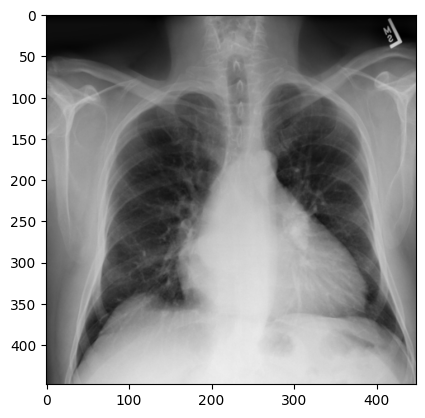

In [ ]:
plt.imshow(img_trans.squeeze(0).permute(1,2,0))
plt.show()

In [ ]:
img_trans.shape

torch.Size([1, 3, 448, 448])

In [ ]:
# image_text_inference.get_similarity_map_from_raw_data(image_path, 'a photo', interpolation = 'bilinear')

Concept:  *Kerly B lines*.

nan


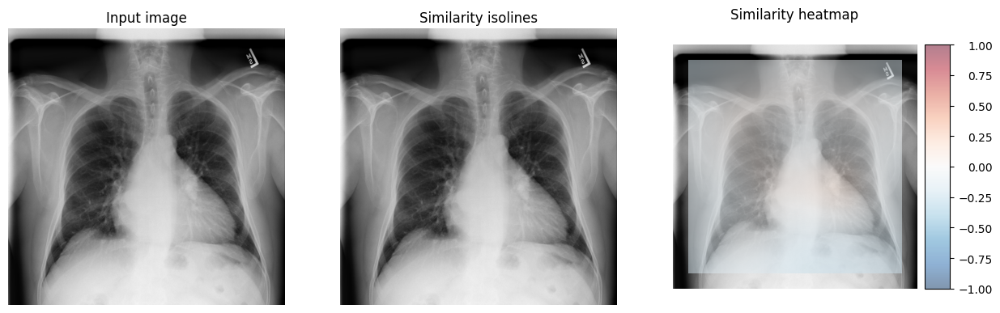

In [ ]:
image_path = Path(image_path)
text_prompt = "Kerly B lines"
# Ground-truth bounding box annotation(s) for the input text prompt
# bboxes = [
#     (802.94, 281.73, 93.18, 105.10),
# ]
bboxes = [
    (306, 168, 124, 101),
]

text = (
    'Concept: '
    f' *{text_prompt}*.'
)

display(Markdown(text))
plot_phrase_grounding(image_path, text_prompt)

TypeError: unsupported format string passed to list.__format__

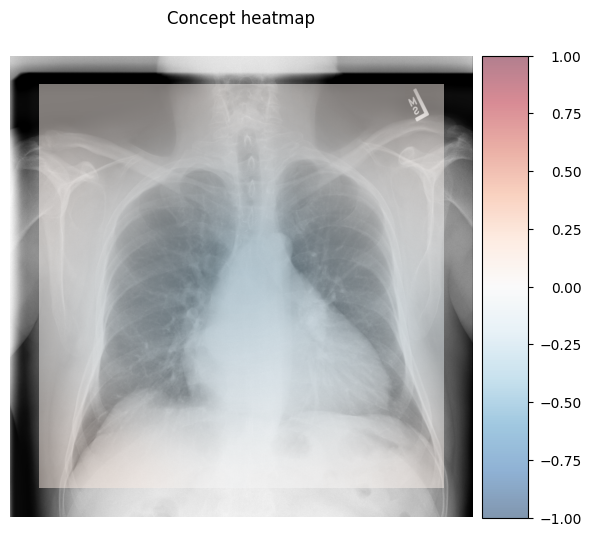

In [ ]:

# for concept in text_prompts
text_prompt = "Alveolar opacities"
similarity_map = image_text_inference.get_similarity_map_from_raw_data(
            image_path=image_path,
            query_text=text_prompt,
            interpolation="bilinear",
        )

image = image_path
img = Image.open(image_path).convert("RGB")

fig, ax = plt.subplots(figsize=(8, 6))
colormap = "RdBu_r"

alpha=0.5
_plot_heatmap(
    image=img,
    heatmap=similarity_map,
    figure=fig,
    axis=ax,
    colormap="RdBu_r",
    title="Concept heatmap",
    alpha=0.5,
)
plt.title(f"Similarity with concept '{text_prompt}' is :{similarity_score:4f}")

# Show the plot
plt.show()

In [ ]:
def plot_similarity_concept_activation_heatmaps(image_paths, text_prompts, image_text_inference):
    """
    Plot similarity heatmaps for a list of images and text prompts.

    Parameters:
    - image_paths: List of image file paths.
    - text_prompts: List of text prompts (concepts).
    - image_text_inference: An instance of the inference model.

    """
    for image_path in image_paths:
        # Open the image
        img = Image.open(image_path).convert("RGB")

        for text_prompt in text_prompts:
            # Compute the similarity map for the current image and text prompt
            similarity_map = image_text_inference.get_similarity_map_from_raw_data(
                image_path=image_path,
                query_text=text_prompt,
                interpolation="bilinear",
            )

            # Compute the similarity score
            similarity_score = image_text_inference.get_similarity_score_from_raw_data(
                image_path=image_path,
                query_text=text_prompt
            )

            # Plot the heatmap
            fig, ax = plt.subplots(figsize=(8, 6))
            colormap = "RdBu_r"
            alpha = 0.5

            _plot_heatmap(
                image=img,
                heatmap=similarity_map,
                figure=fig,
                axis=ax,
                colormap=colormap,
                title="Concept heatmap",
                alpha=alpha,
            )

            plt.title(f"Similarity with concept '{text_prompt}' is :{similarity_score:.4f}")

            # Show the plot
            plt.show()

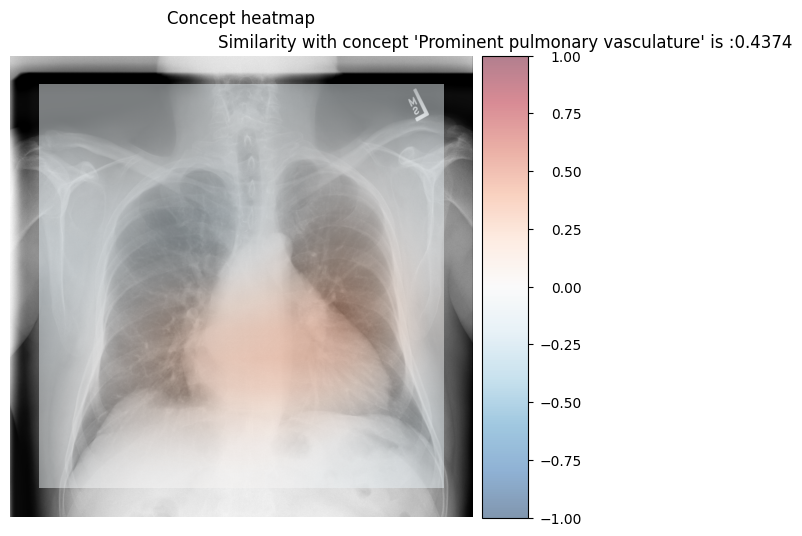

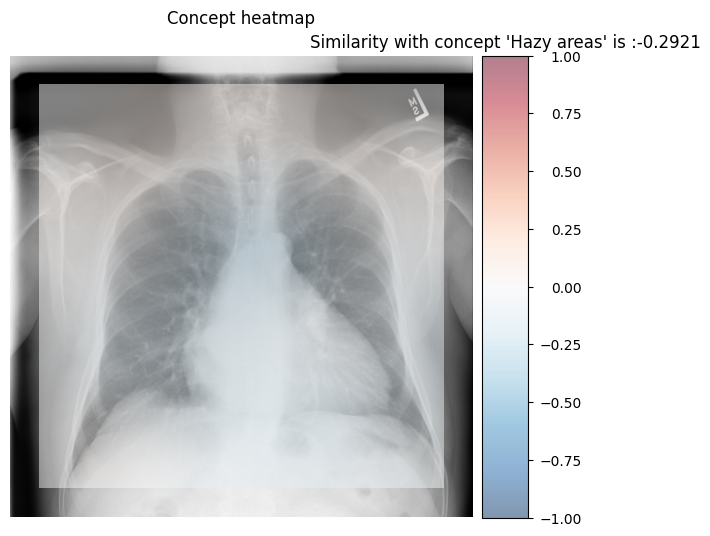

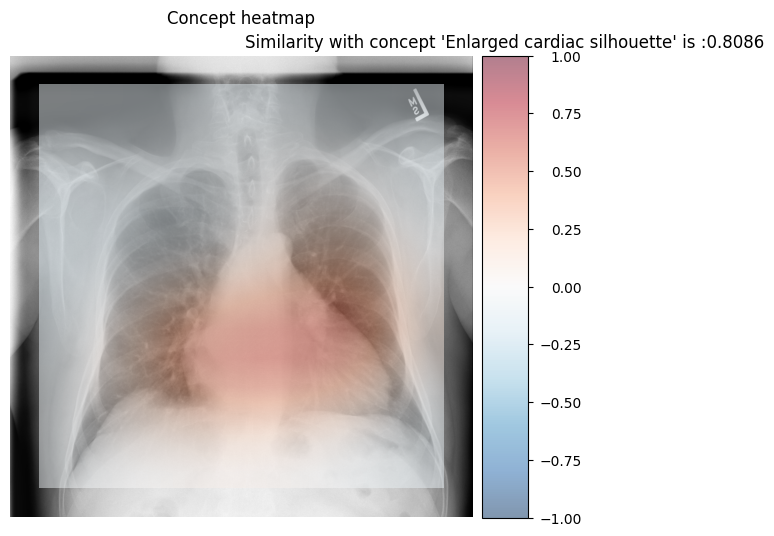

In [ ]:
image_paths = [image_path]
text_prompts = ["Prominent pulmonary vasculature", "Hazy areas", "Enlarged cardiac silhouette"]

# Assuming image_text_inference is an instance of the inference model
plot_similarity_concept_activation_heatmaps(image_paths, text_prompts, image_text_inference)


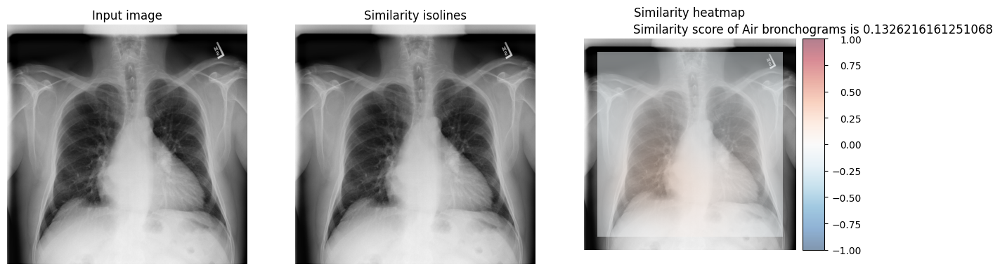

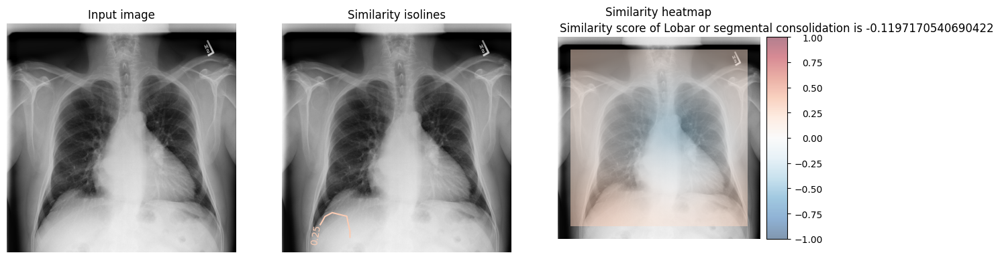

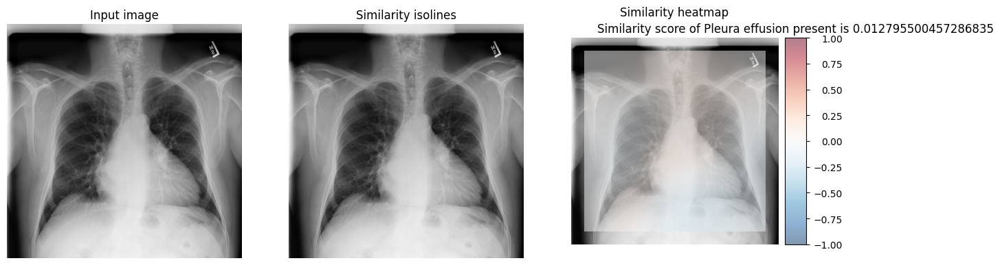

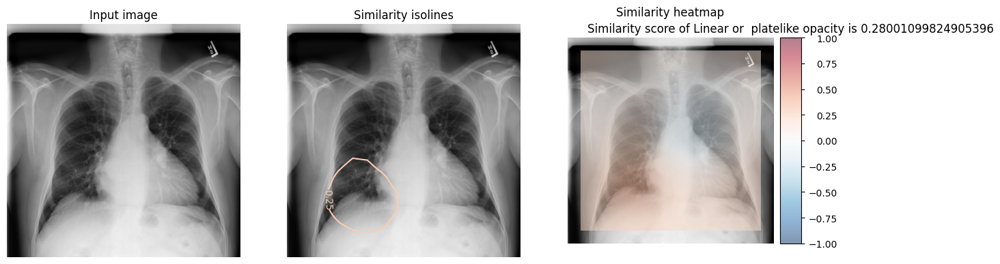

In [ ]:
def plot_heatmap_similarity(image_path: Path, text_prompts: List[str]) -> None:
    for text_prompt in text_prompts:
        similarity_map = image_text_inference.get_similarity_map_from_raw_data(
            image_path=image_path,
            query_text=text_prompt,
            interpolation="bilinear",
        )
        similarity_score = image_text_inference.get_similarity_score_from_raw_data(
                image_path=image_path,
                query_text=text_prompt
            )
        plot_phrase_grounding_similarity_map(
            image_path=image_path,
            similarity_map=similarity_map,
        )
        plt.title(f"Similarity score of {text_prompt} is {similarity_score:4f}")
        plt.show()

image_path = Path("/content/drive/MyDrive/Tubingen_Research/images_samples/00000001_001.png")

# image_path = Path(image_path)
text_prompts = [
# "Lung opacity",
# "Volume loss",
# "Displacement of interlobar fissures",
# "Mediastinal shift towards the affected area",
# "Elevation of the hemidiaphragm",
# "Crowding of pulmonary vessels and bronchi",
# "Silhouette sign",
# "Ground-glass appearance",
# "Hazy areas",
# "Lobulated contours",
# "Displacement of adjacent structures",
# "Increased density compared to surrounding tissue",
# "Compensatory hyperinflation of adjacent lobes",
"Air bronchograms",
"Lobar or segmental consolidation",
"Pleura effusion present",
"Linear or  platelike opacity"]

plot_heatmap_similarity(image_path, text_prompts)

/home/mpindabe/.local/lib/python3.10/site-packages/health_multimodal/common/visualization.py:64: UserWarning: No contour levels were found within the data range.
  contours = axis.contour(


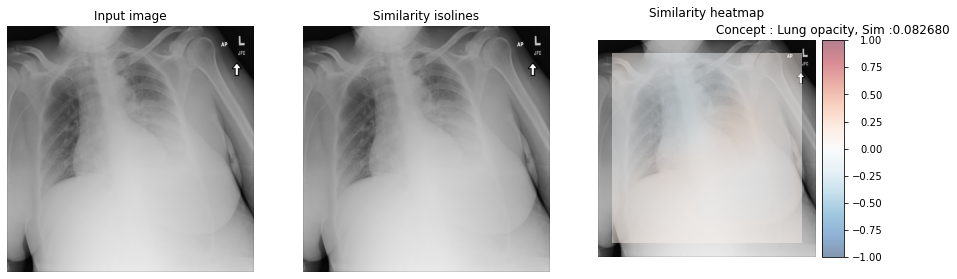

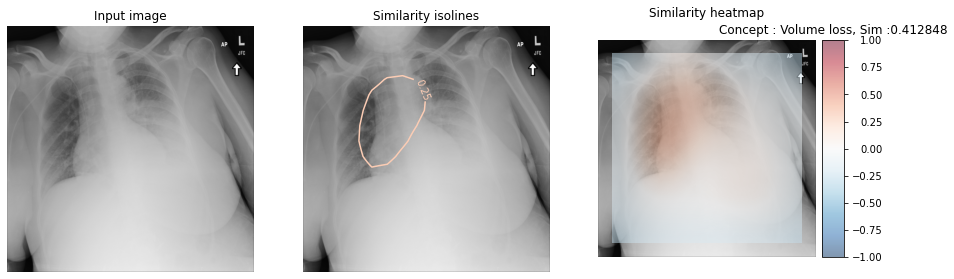

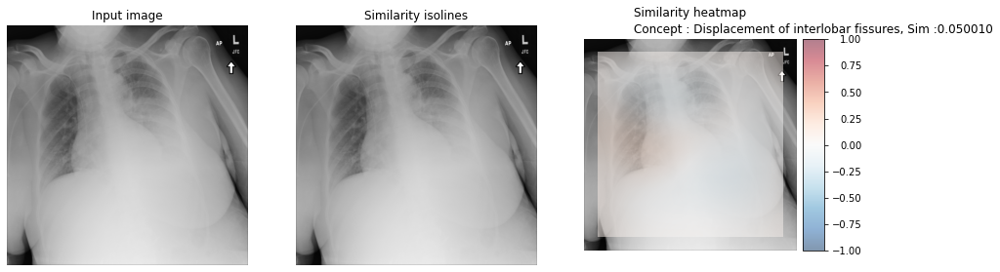

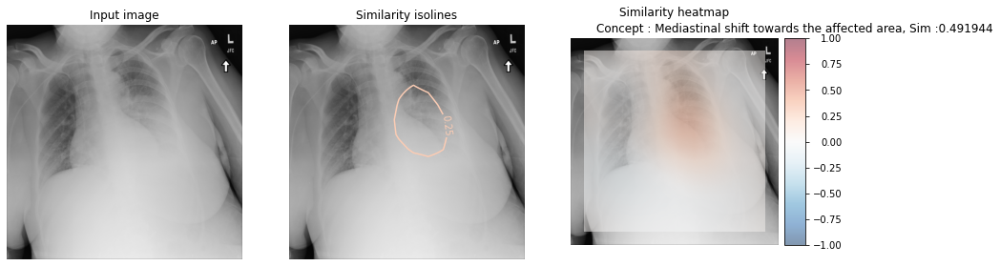

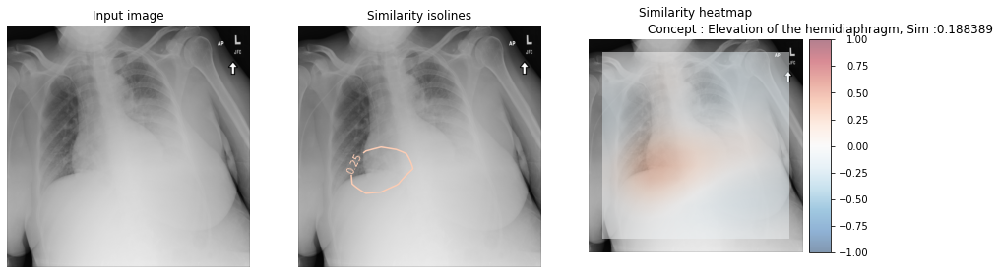

...

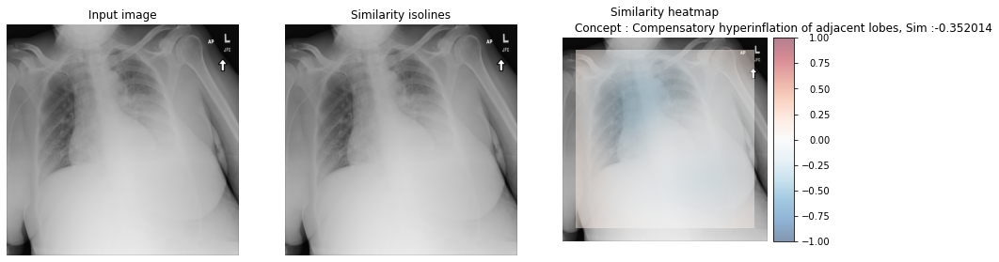

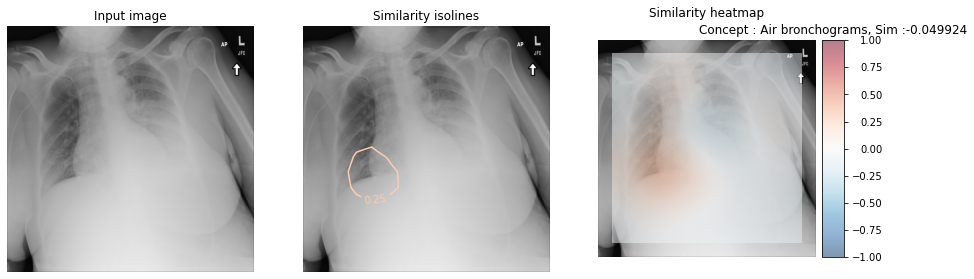

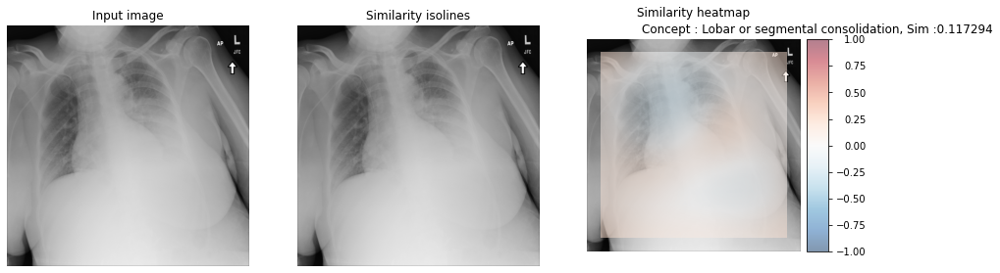

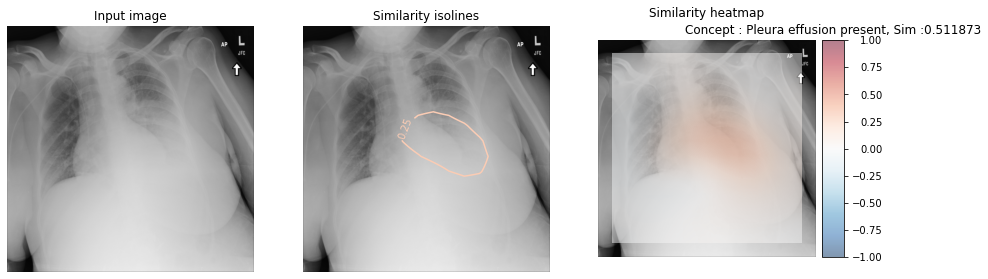

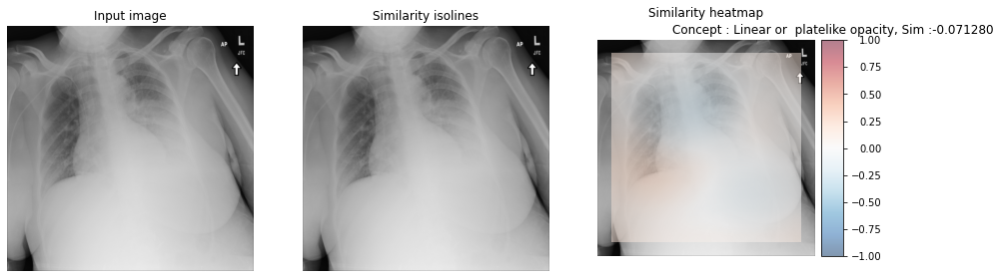

In [ ]:
def plot_get_score_similarity(image_path: Path, text_prompts: List[str]) -> None:
    for text_prompt in text_prompts:
        similarity_score = image_text_inference.get_similarity_score_from_raw_data(
        image_path=image_path,
        query_text=text_prompt)
        # print(similarity_score)

        similarity_map = image_text_inference.get_similarity_map_from_raw_data(
        image_path=image_path,
        query_text=text_prompt,
        interpolation="bilinear",
    )

        plot_phrase_grounding_similarity_map(
            image_path=image_path,
            similarity_map=similarity_map,
        )
        plt.title(f"Concept : {text_prompt}, Sim :{similarity_score:4f}")
        plt.show()


# image_path = Path("/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00001301_044.png")
text_prompts = [
"Lung opacity",
"Volume loss",
"Displacement of interlobar fissures",
"Mediastinal shift towards the affected area",
"Elevation of the hemidiaphragm",
"Crowding of pulmonary vessels and bronchi",
"Silhouette sign",
"Ground-glass appearance",
"Hazy areas",
"Lobulated contours",
"Displacement of adjacent structures",
"Increased density compared to surrounding tissue",
"Compensatory hyperinflation of adjacent lobes",
"Air bronchograms",
"Lobar or segmental consolidation",
"Pleura effusion present",
"Linear or  platelike opacity"]


plot_get_score_similarity(image_path, text_prompts)

/home/mpindabe/.local/lib/python3.10/site-packages/health_multimodal/common/visualization.py:64: UserWarning: No contour levels were found within the data range.
  contours = axis.contour(


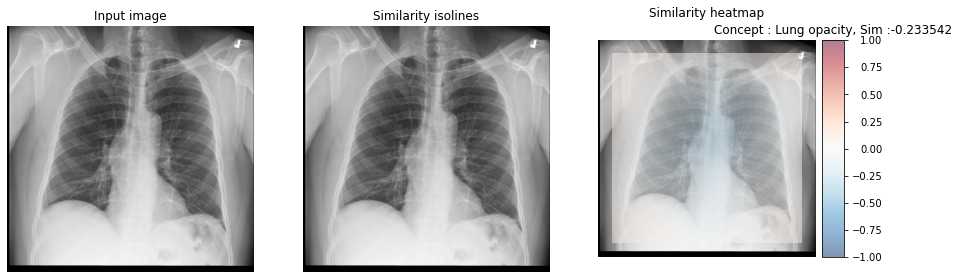

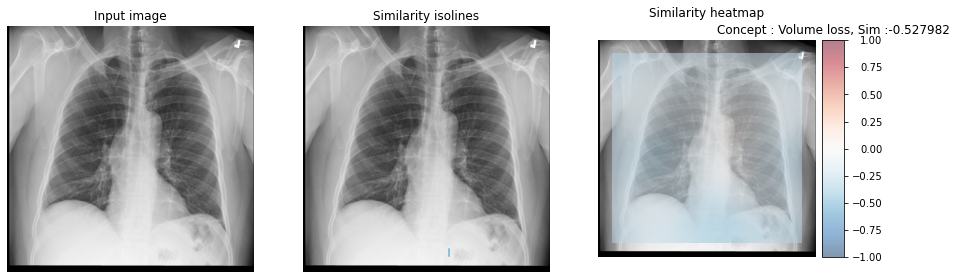

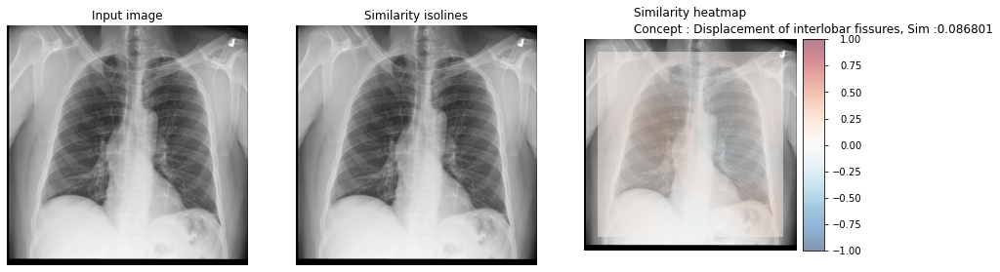

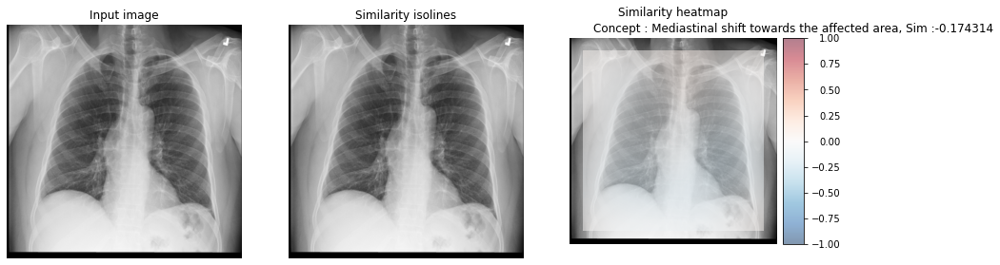

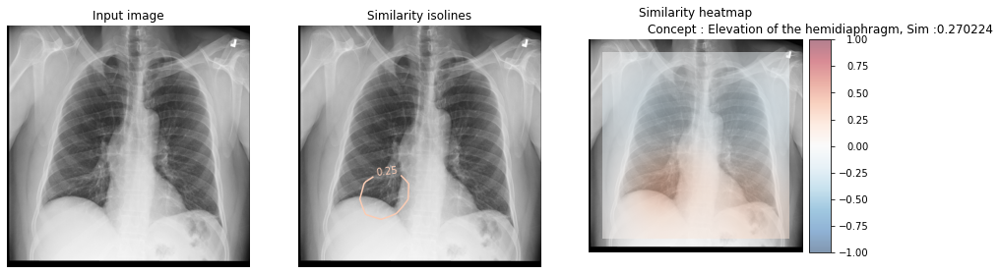

...

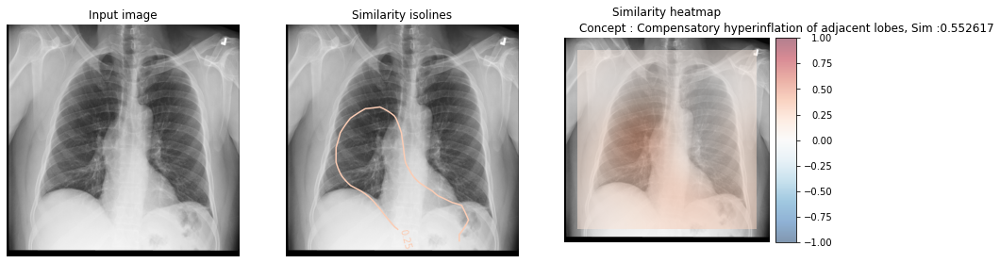

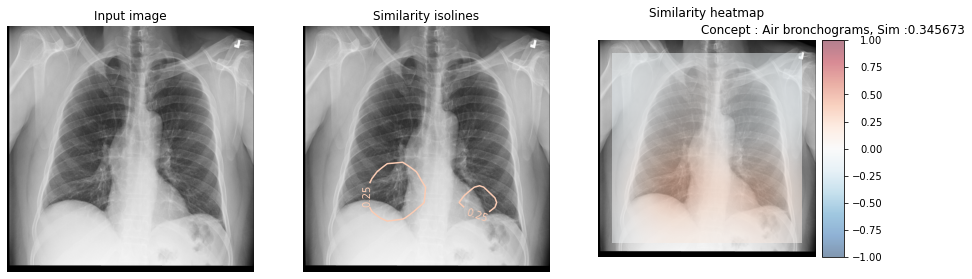

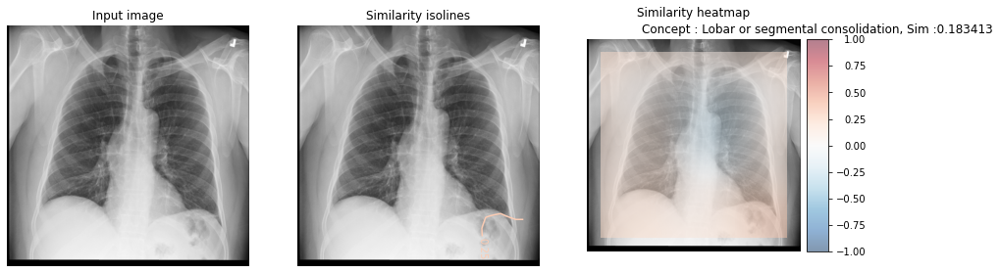

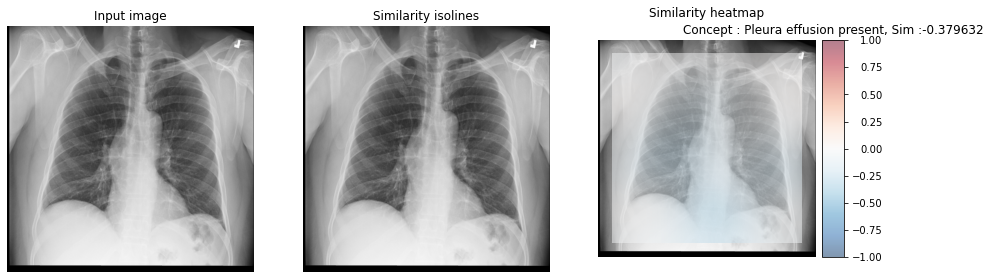

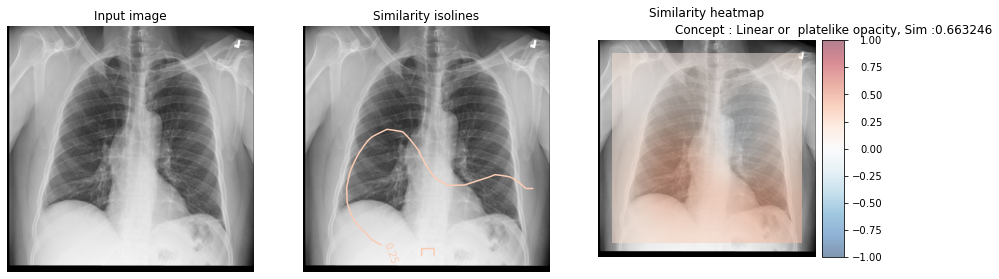

In [ ]:
image_path = Path("/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00000203_000.png") #Atelectasis
# conc_prompts = [
# "Lung opacity",
# "Enlarged cardiac silhouette",
# "Displacement of interlobar fissures",
# "Mediastinal shift towards the affected area",
# "Elevation of the hemidiaphragm",
# "Crowding of pulmonary vessels and bronchi",
# "Presence of alveolar consolidation",
# "Compensatory hyperinflation of adjacent lobes",
# "Flattened diaphragms",
# "Linear or  platelike opacity"]

plot_get_score_similarity(image_path, text_prompts )

/home/mpindabe/.local/lib/python3.10/site-packages/health_multimodal/common/visualization.py:64: UserWarning: No contour levels were found within the data range.
  contours = axis.contour(


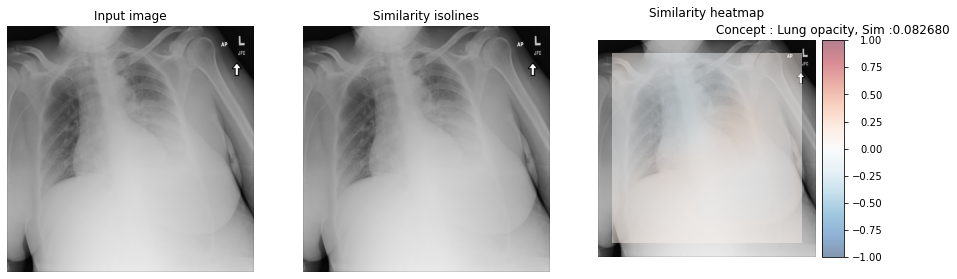

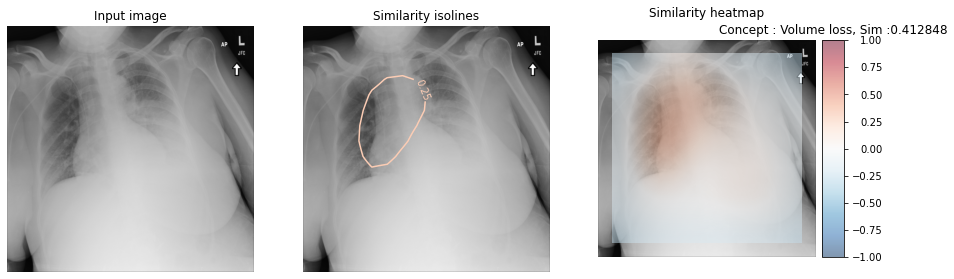

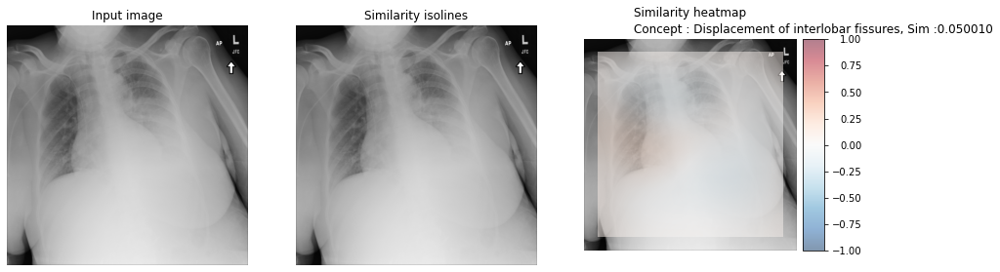

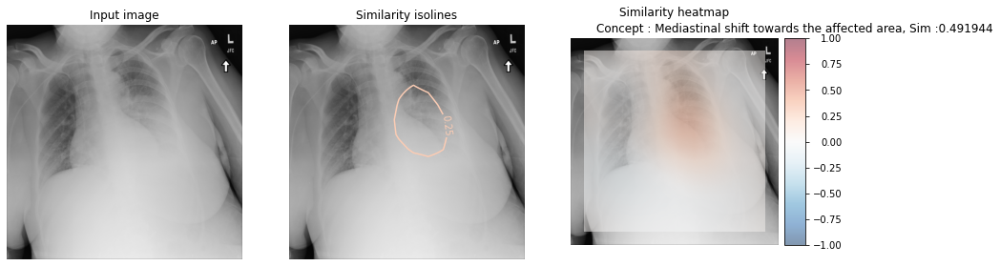

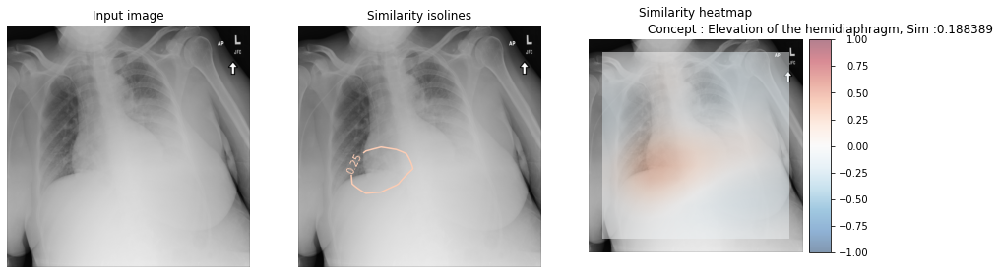

...

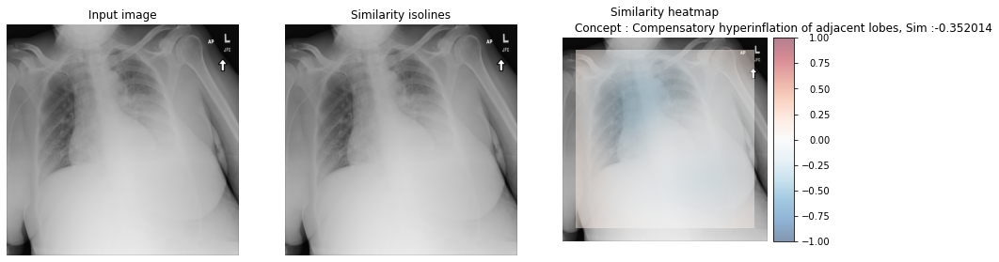

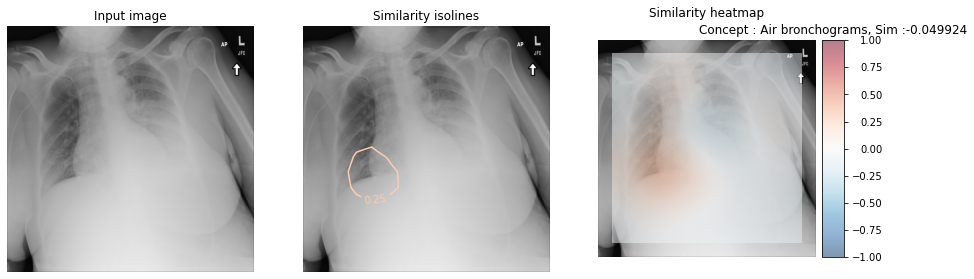

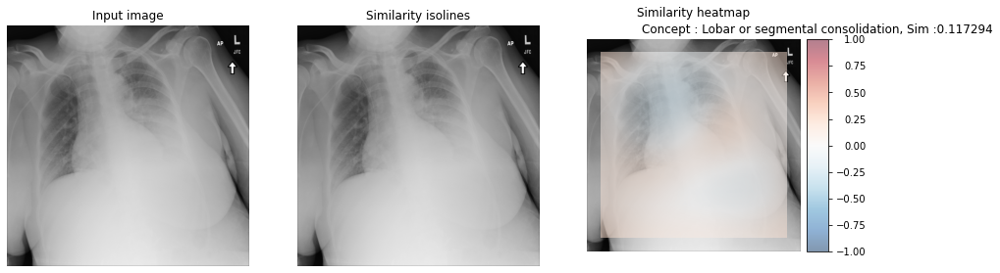

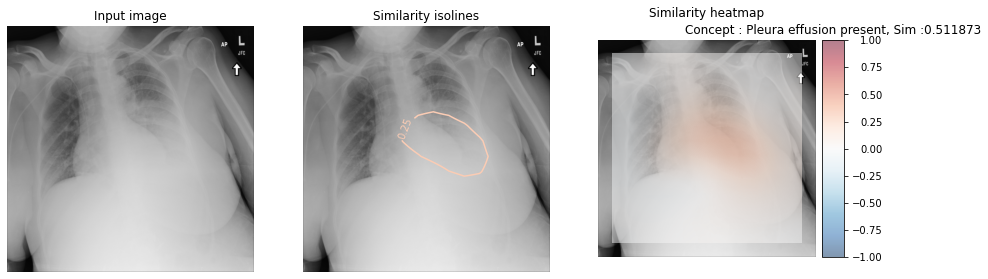

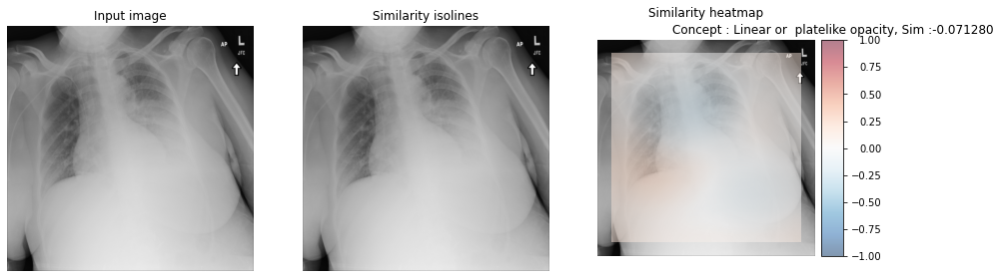

In [ ]:
Image_3 = Path('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00001301_044.png') #Atelectasis|Cardiomegaly|Consolidation|Effusion|Mass
plot_get_score_similarity(Image_3, text_prompts )

/home/mpindabe/.local/lib/python3.10/site-packages/health_multimodal/common/visualization.py:64: UserWarning: No contour levels were found within the data range.
  contours = axis.contour(


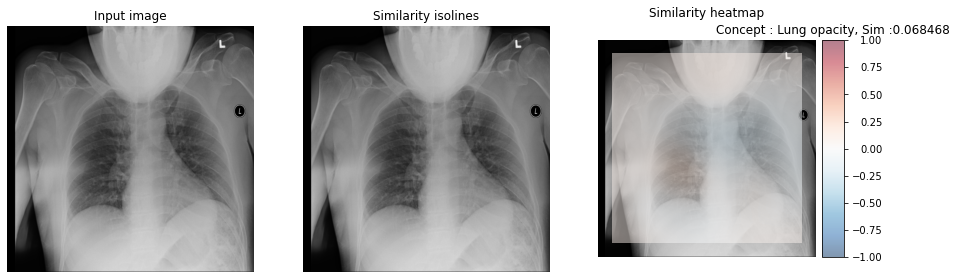

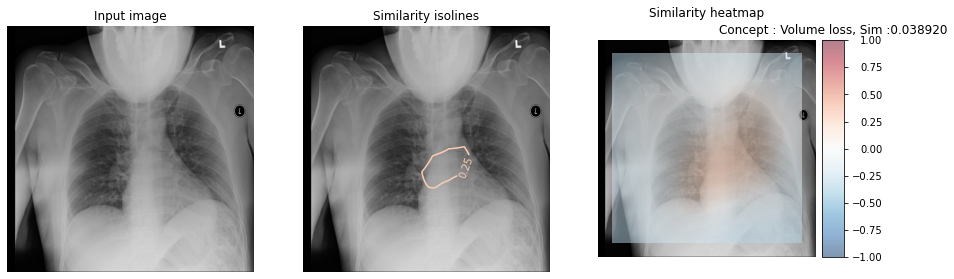

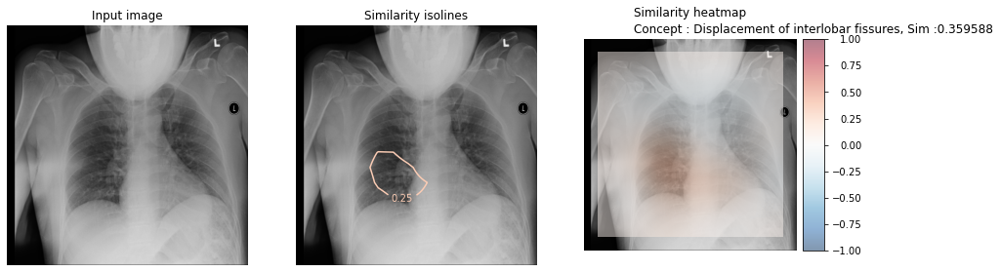

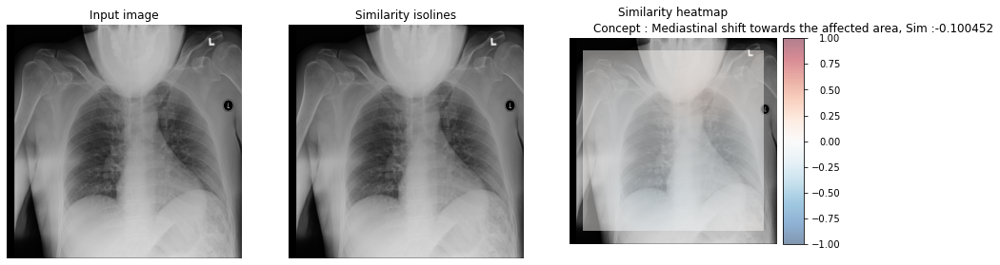

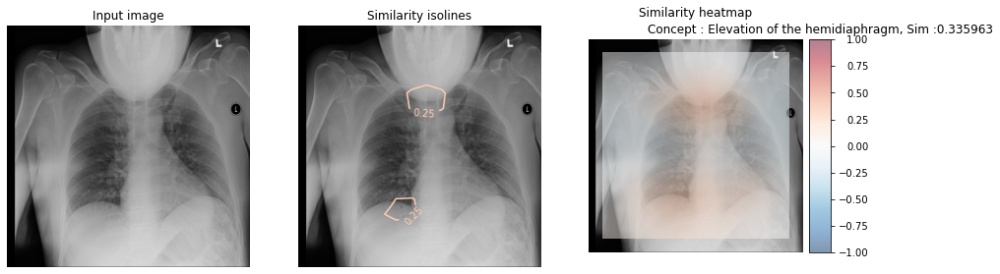

...

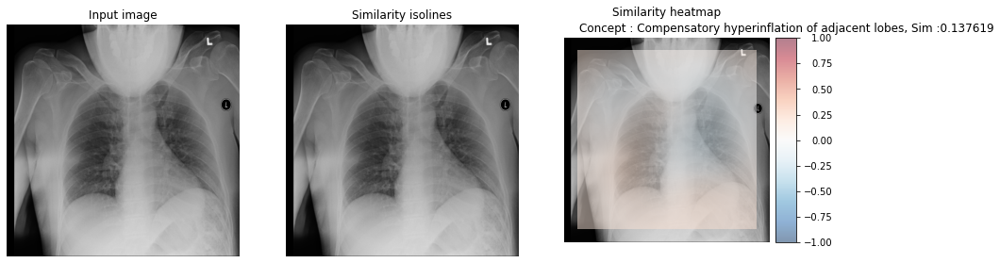

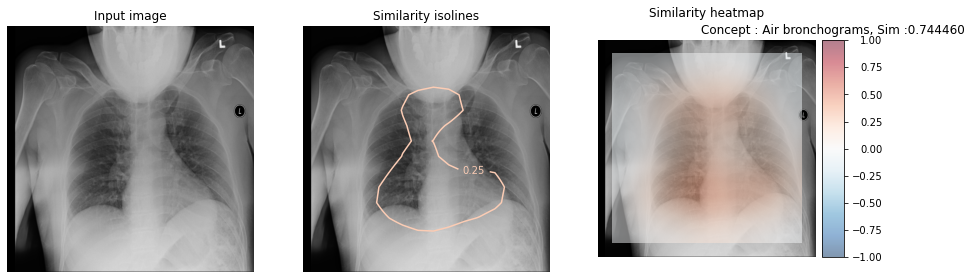

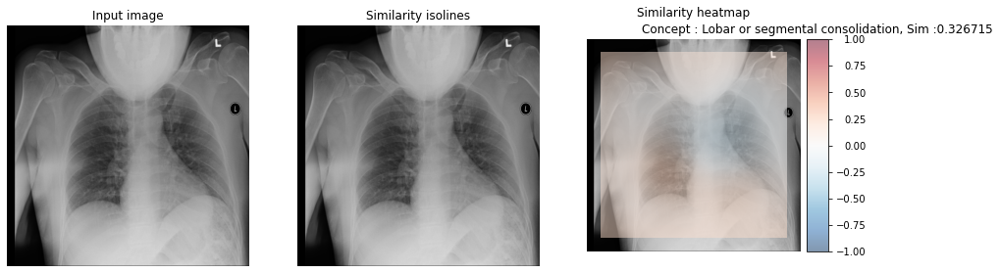

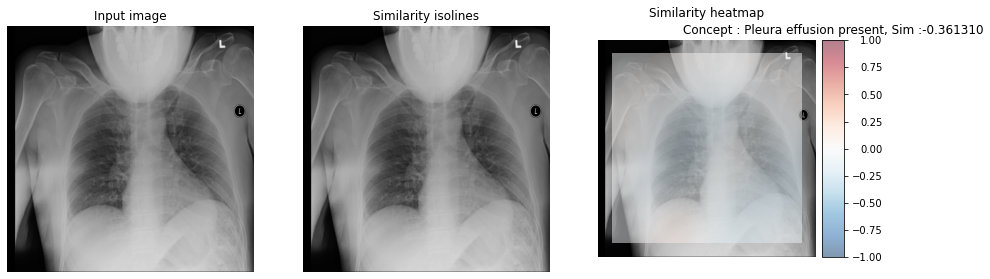

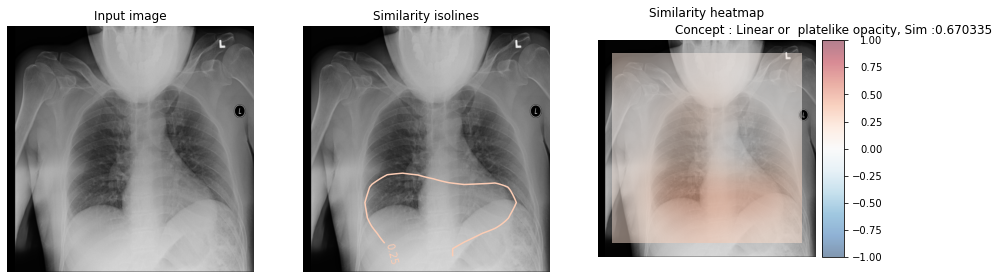

In [ ]:

Image_4 = Path('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00001001_002.png') #label: infiltration
plot_get_score_similarity(Image_4, text_prompts )


In [ ]:
def get_score_similarity(image_path: Path, text_prompts: List[str]) -> List[float]:
    """
    Compute the similarity score between one image and multiple text prompts.

    Args:
    - image_path (Path): Path to the image file.
    - text_prompts (List[str]): List of text prompts.

    Returns:
    - List[float]: Similarity scores for the image with each text prompt.
    """
    similarity_scores = []
    for text_prompt in text_prompts:
        similarity_score = image_text_inference.get_similarity_score_from_raw_data(
            image_path=image_path,
            query_text=text_prompt
        )
        similarity_scores.append(similarity_score)
    return similarity_scores

In [ ]:
image  = Path('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00000758_003.png')
concept_list = [
"Lung opacity",
"Volume loss",
"Displacement of interlobar fissures",
"Mediastinal shift towards the affected area",
"Elevation of the hemidiaphragm",
"Crowding of pulmonary vessels and bronchi",
"Silhouette sign",
"Compensatory hyperinflation of adjacent lobes",
"Linear or  platelike opacity"]

get_score_similarity(image, concept_list)

[-0.06752993166446686,
 0.0850679874420166,
 0.15629033744335175,
 0.4357650876045227,
 0.004896890372037888,
 -0.32177403569221497,
 -0.09699703752994537,
 0.11687015742063522,
 0.2336149513721466]

In [ ]:
def get_patches_emb(image_path: Path) -> torch.Tensor:
    """
    return the patches embedding of the image (14x14,128)
    """
    patch_emb, size =image_inference.get_projected_patch_embeddings(image_path)

    return patch_emb

In [ ]:
get_patches_emb(image_path).shape

FileNotFoundError: No such file: '/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00000457_004.png'

In [ ]:
def compute_and_save_similarity_scores(image_paths: List[Path], text_prompts: List[str], output_file: str):
    """
    Compute similarity scores between multiple images and multiple text prompts, and save them in a CSV file.

    Args:
    - image_paths (List[Path]): List of image file paths.
    - text_prompts (List[str]): List of text prompts.
    - output_file (str): Path to the output CSV file.
    """

    num_images = len(image_paths)
    num_concepts = len(text_prompts)
    similarity_matrix = np.zeros((num_images, num_concepts))

    for i, image_path in enumerate(image_paths):
        similarity_scores = get_score_similarity(image_path, text_prompts)
        similarity_matrix[i, :] = similarity_scores
        print(f"Processed image {i+1}/{num_images}")

    # Save the similarity matrix to a CSV file
    df = pd.DataFrame(similarity_matrix, index=[str(p) for p in image_paths], columns=text_prompts)
    df.to_csv(output_file)
    print(f"Similarity scores saved to {output_file}")

In [ ]:
train_14classes_sorted = pd.read_csv("/graphics/scratch2/students/mpindabe/NHI_XRAY_dataset/cbm_clip_dissect_implementation/NEW_EXPERIMENT_WITH_MEDCLIP/train_14classes_new.csv")
train_14classes_sorted.head()

,Image Index,Finding Labels,Atelectasis,Cardiomegaly,Consolidation,Edema,Effusion,Emphysema,Fibrosis,Hernia,Infiltration,Mass,Nodule,Pleural_Thickening,Pneumonia,Pneumothorax,Target
0,/graphics/scratch2/students/mpindabe/Datasets/...,Atelectasis,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
1,/graphics/scratch2/students/mpindabe/Datasets/...,Atelectasis,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
2,/graphics/scratch2/students/mpindabe/Datasets/...,Atelectasis,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
3,/graphics/scratch2/students/mpindabe/Datasets/...,Atelectasis,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0
4,/graphics/scratch2/students/mpindabe/Datasets/...,Atelectasis,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0


In [ ]:
train_14classes_sorted['Image Index'][200]

'/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00001301_044.png'

In [ ]:
train_14classes_sorted['Finding Labels'][200]

'Atelectasis|Cardiomegaly|Consolidation|Effusion|Mass'

In [ ]:
print(train_14classes_sorted['Image Index'][1500])
print(train_14classes_sorted['Finding Labels'][1500])

/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00001001_002.png
Infiltration


In [ ]:
def get_image_paths_from_csv(dataframe_name: str) -> List[Path]:
    """
    Returns:
    - List[Path]: List of image paths as Path objects.
    """
    DATASET_ROOTS = {
        "xray_train": "/graphics/scratch2/students/mpindabe/NHI_XRAY_dataset/cbm_clip_dissect_implementation/NEW_EXPERIMENT_WITH_MEDCLIP/train_14classes_new.csv"}

    if dataframe_name in DATASET_ROOTS.keys():
        dataframe = pd.read_csv(DATASET_ROOTS[dataframe_name])

    # Assuming the image paths are in the first column
    image_paths = dataframe.iloc[:, 0].tolist()
    return [Path(p) for p in image_paths]

In [ ]:
image_paths = get_image_paths_from_csv('xray_train')
image_paths[5]

PosixPath('/graphics/scratch2/students/mpindabe/Datasets/ChestXray-NIHCC/images_001/images/00000877_025.png')

In [ ]:
with open('/graphics/scratch2/students/mpindabe/NHI_XRAY_dataset/retained_concepts.txt') as f:
    concepts_set  = f.read().splitlines()

print(len(concepts_set))

71


In [ ]:
output_file = "similarity_scores_Biovil.csv"
compute_and_save_similarity_scores(image_paths, concepts_set, output_file)

Processed image 1/2243
Processed image 2/2243
Processed image 3/2243
Processed image 4/2243
Processed image 5/2243
Processed image 6/2243
Processed image 7/2243
Processed image 8/2243
Processed image 9/2243
Processed image 10/2243
Processed image 11/2243
Processed image 12/2243
Processed image 13/2243
Processed image 14/2243
Processed image 15/2243
Processed image 16/2243
Processed image 17/2243
Processed image 18/2243
Processed image 19/2243
Processed image 20/2243
Processed image 21/2243
Processed image 22/2243
Processed image 23/2243
Processed image 24/2243
Processed image 25/2243
Processed image 26/2243
Processed image 27/2243
Processed image 28/2243
Processed image 29/2243
Processed image 30/2243
Processed image 31/2243
Processed image 32/2243
Processed image 33/2243
Processed image 34/2243
Processed image 35/2243
Processed image 36/2243
Processed image 37/2243
Processed image 38/2243
Processed image 39/2243
Processed image 40/2243
Processed image 41/2243
Processed image 42/2243
P

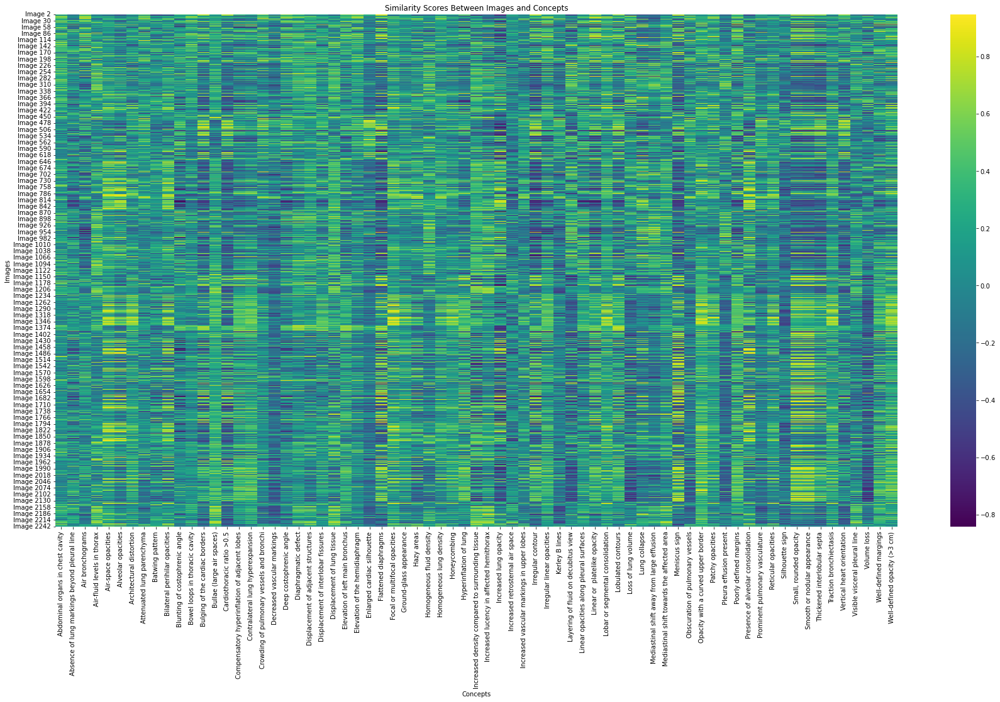

In [ ]:
similarity_df = pd.read_csv("similarity_scores_Biovil.csv", index_col=0)
similarity_df.index = [f"Image {i+1}" for i in range(similarity_df.shape[0])]
# Plot the heatmap
plt.figure(figsize=(30, 15))
sns.heatmap(similarity_df[1:], cmap="viridis", annot=False)
plt.title("Similarity Scores Between Images and Concepts")
plt.xlabel("Concepts")
plt.ylabel("Images")
plt.show()

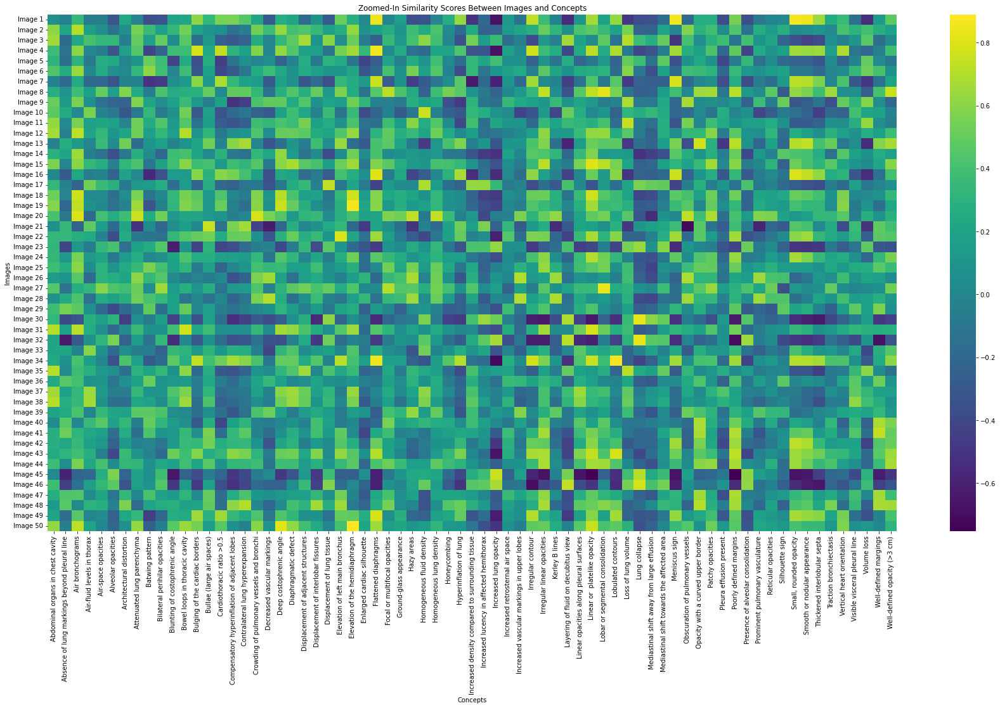

In [ ]:
zoomed_df = similarity_df.iloc[:50, :]

# Plot the zoomed-in heatmap
plt.figure(figsize=(30, 15))
sns.heatmap(zoomed_df, cmap="viridis", annot=False)
plt.title("Zoomed-In Similarity Scores Between Images and Concepts")
plt.xlabel("Concepts")
plt.ylabel("Images")
plt.show()

In [ ]:
max_values_per_row = similarity_df.max(axis=1)

# Print the maximum values per row
print(max_values_per_row)


Image 1       0.865186
Image 2       0.704254
Image 3       0.701160
Image 4       0.856332
Image 5       0.512569
                ...   
Image 2239    0.498700
Image 2240    0.782873
Image 2241    0.704411
Image 2242    0.625344
Image 2243    0.555937
Length: 2243, dtype: float64


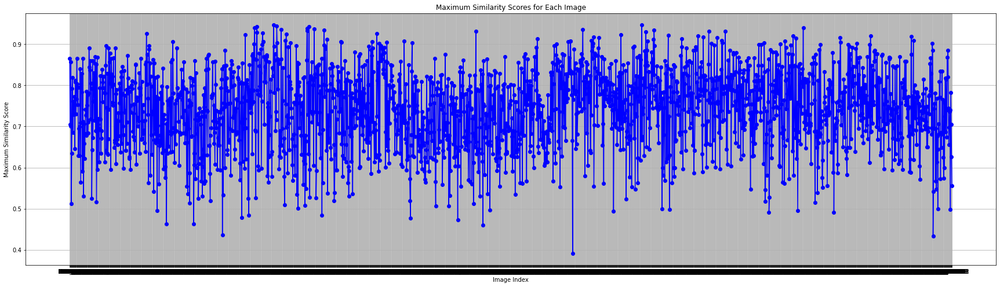

In [ ]:
plt.figure(figsize=(30, 8))
plt.plot(max_values_per_row, marker='o', linestyle='-', color='b')
plt.title("Maximum Similarity Scores for Each Image")
plt.xlabel("Image Index")
plt.ylabel("Maximum Similarity Score")
plt.grid(True)
plt.show()

In [ ]:
image_text_inference.get_similarity_map_from_raw_data(image_path, 'opacity', image_inference)

NotImplementedError: Input Error: Only 3D, 4D and 5D input Tensors supported (got 4D) for the modes: nearest | linear | bilinear | bicubic | trilinear | area | nearest-exact (got <health_multimodal.image.inference_engine.ImageInferenceEngine object at 0x7f8755a6c7c0>)

In [ ]:
def compute_single_similarity_maps(image_path:Path, text_prompts:List[str], image_text_inference, interpolation="bilinear"):
    similarity_maps = []
    for text_prompt in text_prompts:
        similarity_map = image_text_inference.get_similarity_map_from_raw_data(
            image_path=image_path,
            query_text=text_prompt,
            interpolation=interpolation,
        )
        similarity_maps.append(similarity_map)
    return similarity_maps

In [ ]:

text_concept = [
"Hyperinflation of lung",
"Flattened diaphragms",
"Increased retrosternal air space",
"Decreased vascular markings"]
compute_single_similarity_maps(image_path, text_concept, image_inference)

AttributeError: 'ImageInferenceEngine' object has no attribute 'get_similarity_map_from_raw_data'

In [ ]:
def compute_heatmap_similarity(image_path: Path, text_prompts: str) -> None:
    for text_prompt in text_prompts:


        similarity_map = image_text_inference.get_similarity_map_from_raw_data(
        image_path=image_path,
        query_text=text_prompt,
        interpolation="bilinear",
    )
    if np.isnan(similarity_map).any():
            print(f"Warning: NaN values found in similarity map for prompt '{text_prompt}'")
    else:
         return similarity_map[0]

In [ ]:
compute_heatmap_similarity(image_path, "Flattened diaphragms")


In [ ]:
def compute_similarity_maps(image_paths, text_prompts, image_text_inference, interpolation="bilinear"):
    similarity_maps = []
    for image_path in image_paths:
        batch_similarity_maps = []
        for text_prompt in text_prompts:
            similarity_map = image_text_inference.get_similarity_map_from_raw_data(
                image_path=image_path,
                query_text=text_prompt,
                interpolation=interpolation,
            )
            batch_similarity_maps.append(similarity_map)
        similarity_maps.append(batch_similarity_maps)
    return similarity_maps

In [ ]:
def process_batches(image_paths_batch, concepts, image_text_inference):
    text_prompts = concepts  # Assuming concepts is a list of text prompts
    similarity_maps = compute_similarity_maps(image_paths_batch, text_prompts, image_text_inference)
    pooled_heatmaps = apply_average_pooling(similarity_maps)
    return pooled_heatmaps

In [ ]:
def apply_average_pooling(similarity_maps):
    pooled_heatmaps = []
    for batch in similarity_maps:
        batch_pooled_heatmaps = []
        for similarity_map in batch:
            # Convert the similarity map from numpy array to torch tensor
            similarity_map_tensor = torch.from_numpy(similarity_map)
            # Apply average pooling along the specified dimension
            pooled_heatmap = torch.mean(similarity_map_tensor, dim=0)
            batch_pooled_heatmaps.append(pooled_heatmap)
        pooled_heatmaps.append(batch_pooled_heatmaps)
    return pooled_heatmaps

def process_dataset(image_paths, concepts, batch_size, image_text_inference):
    num_samples = len(image_paths)
    pooled_heatmaps_all = []
    for start_idx in range(0, num_samples, batch_size):
        end_idx = min(start_idx + batch_size, num_samples)
        image_paths_batch = image_paths[start_idx:end_idx]
        pooled_heatmaps_batch = process_batches(image_paths_batch, concepts, image_text_inference)
        pooled_heatmaps_all.extend(pooled_heatmaps_batch)
    return pooled_heatmaps_all

In [ ]:
image_paths = get_image_paths_from_csv('xray_train')
concepts = concepts_set
batch_size = 16

image_text_inference = ImageTextInferenceEngine(
    image_inference_engine=image_inference,
    text_inference_engine=text_inference,
)
image_text_inference.to(device)
pooled_heatmaps = process_dataset(image_paths, concepts, batch_size, image_text_inference)

# Convert pooled heatmaps to numpy arrays for visualization or further processing
pooled_heatmaps_np = [[heatmap.cpu().numpy() for heatmap in batch] for batch in pooled_heatmaps]


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
print(pooled_heatmaps_np )

[[array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float

In [ ]:
print(pooled_heatmaps_np)

[[array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float32), array([nan, nan, nan, ..., nan, nan, nan], dtype=float

In [ ]:
a=~4
b=a+4
print(b)

-1
